<a href="https://colab.research.google.com/github/imaanwaziri/Brazillian_E-commerce_project/blob/main/Brazillian_E_commerce_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

1. Test the mpact of Product Category on Order Value by A/B testing
Determine the most popular product categories and their impact on overall sales
2. Identify key factors influencing customer satisfaction and loyalty (photo quantity or delivery)
3. Identify correlations between variables and potential factors influencing sales and customer satisfaction
4. Explore customer demographics, such as location and order frequency
5. Top 3 selling product category and bottom 3

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px


In [2]:
df_products = pd.read_csv('/content/drive/MyDrive/Brazillian E-commerce project/archive/olist_products_dataset.csv')
df_products

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0
...,...,...,...,...,...,...,...,...,...
32946,a0b7d5a992ccda646f2d34e418fff5a0,moveis_decoracao,45.0,67.0,2.0,12300.0,40.0,40.0,40.0
32947,bf4538d88321d0fd4412a93c974510e6,construcao_ferramentas_iluminacao,41.0,971.0,1.0,1700.0,16.0,19.0,16.0
32948,9a7c6041fa9592d9d9ef6cfe62a71f8c,cama_mesa_banho,50.0,799.0,1.0,1400.0,27.0,7.0,27.0
32949,83808703fc0706a22e264b9d75f04a2e,informatica_acessorios,60.0,156.0,2.0,700.0,31.0,13.0,20.0


In [3]:
df_products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32951 entries, 0 to 32950
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   product_id                  32951 non-null  object 
 1   product_category_name       32341 non-null  object 
 2   product_name_lenght         32341 non-null  float64
 3   product_description_lenght  32341 non-null  float64
 4   product_photos_qty          32341 non-null  float64
 5   product_weight_g            32949 non-null  float64
 6   product_length_cm           32949 non-null  float64
 7   product_height_cm           32949 non-null  float64
 8   product_width_cm            32949 non-null  float64
dtypes: float64(7), object(2)
memory usage: 2.3+ MB


In [4]:
df_order_items = pd.read_csv('/content/drive/MyDrive/Brazillian E-commerce project/archive/olist_order_items_dataset.csv')
df_order_items

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14
...,...,...,...,...,...,...,...
112645,fffc94f6ce00a00581880bf54a75a037,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-05-02 04:11:01,299.99,43.41
112646,fffcd46ef2263f404302a634eb57f7eb,1,32e07fd915822b0765e448c4dd74c828,f3c38ab652836d21de61fb8314b69182,2018-07-20 04:31:48,350.00,36.53
112647,fffce4705a9662cd70adb13d4a31832d,1,72a30483855e2eafc67aee5dc2560482,c3cfdc648177fdbbbb35635a37472c53,2017-10-30 17:14:25,99.90,16.95
112648,fffe18544ffabc95dfada21779c9644f,1,9c422a519119dcad7575db5af1ba540e,2b3e4a2a3ea8e01938cabda2a3e5cc79,2017-08-21 00:04:32,55.99,8.72


In [5]:
df_order_items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   order_id             112650 non-null  object 
 1   order_item_id        112650 non-null  int64  
 2   product_id           112650 non-null  object 
 3   seller_id            112650 non-null  object 
 4   shipping_limit_date  112650 non-null  object 
 5   price                112650 non-null  float64
 6   freight_value        112650 non-null  float64
dtypes: float64(2), int64(1), object(4)
memory usage: 6.0+ MB


In [6]:
df_orders = pd.read_csv('/content/drive/MyDrive/Brazillian E-commerce project/archive/olist_orders_dataset.csv')
df_orders

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00
...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28 00:00:00
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02 00:00:00
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27 00:00:00
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15 00:00:00


In [7]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [8]:
df_order_reviews = pd.read_csv("/content/drive/MyDrive/Brazillian E-commerce project/archive/olist_order_reviews_dataset.csv")

df_order_reviews

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53
...,...,...,...,...,...,...,...
99219,574ed12dd733e5fa530cfd4bbf39d7c9,2a8c23fee101d4d5662fa670396eb8da,5,NaN,NaN,2018-07-07 00:00:00,2018-07-14 17:18:30
99220,f3897127253a9592a73be9bdfdf4ed7a,22ec9f0669f784db00fa86d035cf8602,5,NaN,NaN,2017-12-09 00:00:00,2017-12-11 20:06:42
99221,b3de70c89b1510c4cd3d0649fd302472,55d4004744368f5571d1f590031933e4,5,NaN,"Excelente mochila, entrega super rápida. Super...",2018-03-22 00:00:00,2018-03-23 09:10:43
99222,1adeb9d84d72fe4e337617733eb85149,7725825d039fc1f0ceb7635e3f7d9206,4,NaN,NaN,2018-07-01 00:00:00,2018-07-02 12:59:13


In [9]:
#Clean data by changing the data type of the following: shipping_limit_date,review_creation_date,review_answer_timestamp

df_order_items ['shipping_limit_date'] = pd.to_datetime(
    df_order_items['shipping_limit_date'],
    format = '%Y-%m-%d',
    errors = 'coerce'
    )

df_order_reviews['review_creation_date'] = pd.to_datetime (
    df_order_reviews['review_creation_date'],
    format = '%Y-%m-%d',
    errors = 'coerce'
    )

df_order_reviews['review_answer_timestamp'] = pd.to_datetime (
    df_order_reviews['review_answer_timestamp'],
    format = '%Y-%m-%d',
    errors = 'coerce'
    )

In [10]:
df_order_items.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   order_id             112650 non-null  object        
 1   order_item_id        112650 non-null  int64         
 2   product_id           112650 non-null  object        
 3   seller_id            112650 non-null  object        
 4   shipping_limit_date  0 non-null       datetime64[ns]
 5   price                112650 non-null  float64       
 6   freight_value        112650 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(1), object(3)
memory usage: 6.0+ MB


In [11]:
df_prod_orders = pd.merge(
    df_order_items,
    df_products,
    on= 'product_id',
    how='inner'
    )
df_prod_orders

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,58.9,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
1,130898c0987d1801452a8ed92a670612,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,55.9,17.96,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
2,532ed5e14e24ae1f0d735b91524b98b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,64.9,18.33,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
3,6f8c31653edb8c83e1a739408b5ff750,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,58.9,16.17,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
4,7d19f4ef4d04461989632411b7e588b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,58.9,13.29,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112645,ffebd80e3291e811c308365936897efd,1,4cc4d02efc8f249c13355147fb44e34d,d1c7fa84e48cfa21a0e595167c1c500e,NaT,129.9,51.20,ferramentas_jardim,37.0,653.0,1.0,6700.0,35.0,12.0,22.0
112646,ffee31fb4b5e35c9123608015637c495,1,b10ecf8e33aaaea419a9fa860ea80fb5,0241d4d5d36f10f80c644447315af0bd,NaT,99.0,13.52,moveis_decoracao,30.0,308.0,1.0,2300.0,37.0,30.0,20.0
112647,fff7c4452f050315db1b3f24d9df5fcd,1,dd469c03ad67e201bc2179ef077dcd48,7e93a43ef30c4f03f38b393420bc753a,NaT,736.0,20.91,relogios_presentes,33.0,658.0,3.0,400.0,19.0,9.0,15.0
112648,fffa82886406ccf10c7b4e35c4ff2788,1,bbe7651fef80287a816ead73f065fc4b,8f2ce03f928b567e3d56181ae20ae952,NaT,229.9,44.02,esporte_lazer,32.0,280.0,2.0,2700.0,60.0,15.0,15.0


In [12]:
df_prod_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 15 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   order_id                    112650 non-null  object        
 1   order_item_id               112650 non-null  int64         
 2   product_id                  112650 non-null  object        
 3   seller_id                   112650 non-null  object        
 4   shipping_limit_date         0 non-null       datetime64[ns]
 5   price                       112650 non-null  float64       
 6   freight_value               112650 non-null  float64       
 7   product_category_name       111047 non-null  object        
 8   product_name_lenght         111047 non-null  float64       
 9   product_description_lenght  111047 non-null  float64       
 10  product_photos_qty          111047 non-null  float64       
 11  product_weight_g            112632 non-

In [13]:
product_price = pd.DataFrame(df_prod_orders.groupby("product_category_name")["price"].sum())
product_price

,price
product_category_name,
agro_industria_e_comercio,72530.47
alimentos,29393.41
alimentos_bebidas,15179.48
artes,24202.64
artes_e_artesanato,1814.01
...,...
sinalizacao_e_seguranca,21509.23
tablets_impressao_imagem,7528.41
telefonia,323667.53


In [14]:
product_price.reset_index(inplace=True)
product_price

,product_category_name,price
0,agro_industria_e_comercio,72530.47
1,alimentos,29393.41
2,alimentos_bebidas,15179.48
3,artes,24202.64
4,artes_e_artesanato,1814.01
...,...,...
68,sinalizacao_e_seguranca,21509.23
69,tablets_impressao_imagem,7528.41
70,telefonia,323667.53
71,telefonia_fixa,59583.00


In [15]:
px.histogram(product_price,
                          x='product_category_name',
                          y='price',
                          color = 'product_category_name',
                          title = 'Price per Product'
                                         )

In [16]:
df_order_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 7 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   review_id                99224 non-null  object        
 1   order_id                 99224 non-null  object        
 2   review_score             99224 non-null  int64         
 3   review_comment_title     11568 non-null  object        
 4   review_comment_message   40977 non-null  object        
 5   review_creation_date     0 non-null      datetime64[ns]
 6   review_answer_timestamp  0 non-null      datetime64[ns]
dtypes: datetime64[ns](2), int64(1), object(4)
memory usage: 5.3+ MB


In [17]:
# Join df_order_items and df_order_reviews on 'order_id'

df_order_reviews = pd.merge(
    df_order_items,
    df_order_reviews,
    on= 'order_id',
    how='inner'
    )

df_order_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112372 entries, 0 to 112371
Data columns (total 13 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   order_id                 112372 non-null  object        
 1   order_item_id            112372 non-null  int64         
 2   product_id               112372 non-null  object        
 3   seller_id                112372 non-null  object        
 4   shipping_limit_date      0 non-null       datetime64[ns]
 5   price                    112372 non-null  float64       
 6   freight_value            112372 non-null  float64       
 7   review_id                112372 non-null  object        
 8   review_score             112372 non-null  int64         
 9   review_comment_title     13434 non-null   object        
 10  review_comment_message   47642 non-null   object        
 11  review_creation_date     0 non-null       datetime64[ns]
 12  review_answer_ti

In [18]:
# Join df_order_reviews and df_products on 'product_id'
df_order_reviews_products = pd.merge(
    df_order_reviews,
    df_products,
    on= 'product_id',
    how='inner'
    )

df_order_reviews_products.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112372 entries, 0 to 112371
Data columns (total 21 columns):
 #   Column                      Non-Null Count   Dtype         
---  ------                      --------------   -----         
 0   order_id                    112372 non-null  object        
 1   order_item_id               112372 non-null  int64         
 2   product_id                  112372 non-null  object        
 3   seller_id                   112372 non-null  object        
 4   shipping_limit_date         0 non-null       datetime64[ns]
 5   price                       112372 non-null  float64       
 6   freight_value               112372 non-null  float64       
 7   review_id                   112372 non-null  object        
 8   review_score                112372 non-null  int64         
 9   review_comment_title        13434 non-null   object        
 10  review_comment_message      47642 non-null   object        
 11  review_creation_date        0 non-null 

In [19]:
df_order_reviews_products

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,review_id,review_score,review_comment_title,...,review_creation_date,review_answer_timestamp,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,58.9,13.29,97ca439bc427b48bc1cd7177abe71365,5,NaN,...,NaT,NaT,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
1,130898c0987d1801452a8ed92a670612,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,55.9,17.96,b11cba360bbe71410c291b764753d37f,5,NaN,...,NaT,NaT,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
2,532ed5e14e24ae1f0d735b91524b98b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,64.9,18.33,af01c4017c5ab46df6cc810e069e654a,4,super recomendo,...,NaT,NaT,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
3,6f8c31653edb8c83e1a739408b5ff750,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,58.9,16.17,8304ff37d8b16b57086fa283fe0c44f8,5,NaN,...,NaT,NaT,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
4,7d19f4ef4d04461989632411b7e588b9,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,NaT,58.9,13.29,426f43a82185969503fb3c86241a9535,5,NaN,...,NaT,NaT,cool_stuff,58.0,598.0,4.0,650.0,28.0,9.0,14.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112367,ffebd80e3291e811c308365936897efd,1,4cc4d02efc8f249c13355147fb44e34d,d1c7fa84e48cfa21a0e595167c1c500e,NaT,129.9,51.20,d8b7a27e0ca2736c310d24a87bcba62a,5,NaN,...,NaT,NaT,ferramentas_jardim,37.0,653.0,1.0,6700.0,35.0,12.0,22.0
112368,ffee31fb4b5e35c9123608015637c495,1,b10ecf8e33aaaea419a9fa860ea80fb5,0241d4d5d36f10f80c644447315af0bd,NaT,99.0,13.52,4e78f83fed69a70a3eb2796a9f24b368,4,NaN,...,NaT,NaT,moveis_decoracao,30.0,308.0,1.0,2300.0,37.0,30.0,20.0
112369,fff7c4452f050315db1b3f24d9df5fcd,1,dd469c03ad67e201bc2179ef077dcd48,7e93a43ef30c4f03f38b393420bc753a,NaT,736.0,20.91,18fd272eb3b30d832d8f459ca0bfc24b,5,NaN,...,NaT,NaT,relogios_presentes,33.0,658.0,3.0,400.0,19.0,9.0,15.0
112370,fffa82886406ccf10c7b4e35c4ff2788,1,bbe7651fef80287a816ead73f065fc4b,8f2ce03f928b567e3d56181ae20ae952,NaT,229.9,44.02,b49f4e0ca71a9801d56ff4e47cff1ded,4,NaN,...,NaT,NaT,esporte_lazer,32.0,280.0,2.0,2700.0,60.0,15.0,15.0


In [20]:
# Question 1: What products categories are more prone to customer satisfaction & dissatisfaction?

# Create new df using only 'product_category_name' and the mean 'review_score'
df_mean_scores = df_order_reviews_products.groupby('product_category_name')['review_score'].mean().reset_index()

# Create a line chart using the mean scores
product_category_by_mean_score = px.line(df_mean_scores,
                                         x='product_category_name',
                                         y='review_score',
                                         title= 'Product Category by Avg. Review Score',
                                         )

# Update y-axis range
product_category_by_mean_score.update_yaxes(range=[0, 5])

# Format chart to be presentable
product_category_by_mean_score.update_layout(
    xaxis_title= 'Product Category',
    yaxis_title= 'Review Score',
)

# Show the chart
product_category_by_mean_score.show()

In [30]:
# Identify the top and bottom product categories based on review score
product_cat_review_mean = df_order_reviews_products.groupby('product_category_name')['review_score'].mean().sort_values()

In [35]:
print(type(product_cat_review_mean))

<class 'pandas.core.series.Series'>


In [39]:
df_product_cat_review_mean = pd.DataFrame(product_cat_review_mean).reset_index(drop=False)
df_product_cat_review_mean

,product_category_name,review_score
0,seguros_e_servicos,2.500000
1,fraldas_higiene,3.256410
2,portateis_cozinha_e_preparadores_de_alimentos,3.266667
3,pc_gamer,3.333333
4,moveis_escritorio,3.493183
...,...,...
68,flores,4.419355
69,construcao_ferramentas_ferramentas,4.444444
70,livros_interesse_geral,4.446266
71,fashion_roupa_infanto_juvenil,4.500000


In [56]:
# Randomly split the DataFrame into two
product_cat_review_group1 = df_product_cat_review_mean.sample(frac=0.5, random_state=1)  # First half of the DataFrame
product_cat_review_group2 = df_product_cat_review_mean.drop(product_cat_review_group1.index)  # Second half of the DataFrame

In [59]:
import scipy.stats as stats

# Extract the relevant data for the ANOVA test from the two groups
data_group1 = product_cat_review_group1['review_score'].dropna()  # Replace 'column' with the actual column containing your data
data_group2 = product_cat_review_group2['review_score'].dropna()

# Perform the ANOVA test
f_statistic, p_value = stats.f_oneway(data_group1, data_group2)

# Interpret the result
alpha = 0.05
print("F-statistic:", f_statistic)
print("p-value:", p_value)
if p_value < alpha:
    print("Reject null hypothesis: There is a statistically significant difference in average order values across different product categories.")
else:
    print("Fail to reject null hypothesis: There is no statistically significant difference in average order values across different product categories.")


F-statistic: 4.03630684096957
p-value: 0.04833423885600759
Reject null hypothesis: There is a statistically significant difference in average order values across different product categories.


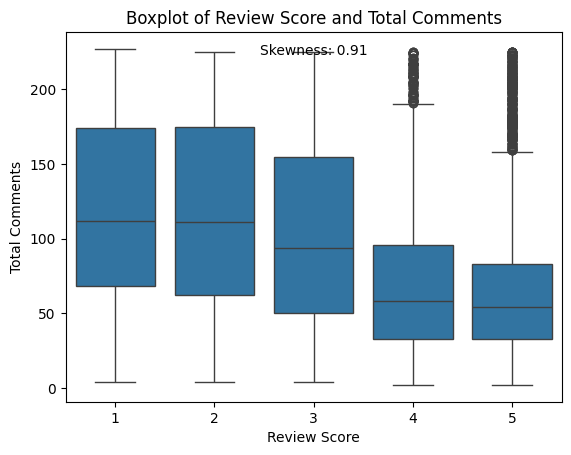

In [ ]:
# Question 2: Is there a connection between reviews and customer satisfaction score?


# Create a new column for the total number of comments
df_order_reviews_products['total_comments'] = df_order_reviews_products['review_comment_title'].str.len() + df_order_reviews_products['review_comment_message'].str.len()

# Create a box plot to showcase the data
sns.boxplot(x= df_order_reviews_products['review_score'], y= df_order_reviews_products['total_comments'])

# Set labels and titles
plt.xlabel('Review Score')
plt.ylabel('Total Comments')
plt.title('Boxplot of Review Score and Total Comments')

# Calculate and display skewness
skewness = df_order_reviews_products['total_comments'].skew()
plt.annotate(f'Skewness: {skewness:.2f}',
             xy=(0.5, 0.95),
             xycoords='axes fraction',
             ha='center',
             va='center',
             fontsize=10,
             )


plt.show()

In [ ]:
#Is there a connection between product photo quantity, and customer satisfaction?


photo_qty_by_satisfaction = px.histogram(df_order_reviews_products,
                                         x='review_score',
                                         y='product_photos_qty',
                                         color = 'review_score',
                                         title = 'Photo Product Quantity by Review Score'
                                         )
photo_qty_by_satisfaction

In [ ]:
df_order_customer_dataset = pd.read_csv('/content/drive/MyDrive/Brazillian E-commerce project/archive/olist_customers_dataset.csv')
df_order_customer_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [ ]:
df_order_customer_dataset.rename(columns={'customer_zip_code_prefix':'zip_code_prefix'}, inplace= True)

In [ ]:
df_order_customer_dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   customer_id         99441 non-null  object
 1   customer_unique_id  99441 non-null  object
 2   zip_code_prefix     99441 non-null  int64 
 3   customer_city       99441 non-null  object
 4   customer_state      99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB


In [ ]:
df_geolocation = pd.read_csv('/content/drive/MyDrive/Brazillian E-commerce project/archive/olist_geolocation_dataset.csv')
df_geolocation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000163 entries, 0 to 1000162
Data columns (total 5 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   geolocation_zip_code_prefix  1000163 non-null  int64  
 1   geolocation_lat              1000163 non-null  float64
 2   geolocation_lng              1000163 non-null  float64
 3   geolocation_city             1000163 non-null  object 
 4   geolocation_state            1000163 non-null  object 
dtypes: float64(2), int64(1), object(2)
memory usage: 38.2+ MB


In [ ]:
df_geolocation.rename(columns={'geolocation_zip_code_prefix':'zip_code_prefix'}, inplace= True)

In [ ]:
df_customer_geolocation = pd.merge(df_order_customer_dataset,
                                   df_geolocation,
                                   on= 'zip_code_prefix',
                                   how='inner'
                                   )

df_customer_geolocation.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15083455 entries, 0 to 15083454
Data columns (total 9 columns):
 #   Column              Dtype  
---  ------              -----  
 0   customer_id         object 
 1   customer_unique_id  object 
 2   zip_code_prefix     int64  
 3   customer_city       object 
 4   customer_state      object 
 5   geolocation_lat     float64
 6   geolocation_lng     float64
 7   geolocation_city    object 
 8   geolocation_state   object 
dtypes: float64(2), int64(1), object(6)
memory usage: 1.1+ GB


In [ ]:
df_customer_geolocation.isnull()

,customer_id,customer_unique_id,zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...
15083450,False,False,False,False,False,False,False,False,False
15083451,False,False,False,False,False,False,False,False,False
15083452,False,False,False,False,False,False,False,False,False
15083453,False,False,False,False,False,False,False,False,False


In [ ]:
!pip install folium --quiet

In [ ]:
import folium

# Create a map object
m = folium.Map(location= [-8.18056914443569, -55.92136978459308], zoom_start=4)

m

In [ ]:
#dataframe with latitude, longitude, and city
df_locations = df_customer_geolocation[['geolocation_lat', 'geolocation_lng', 'geolocation_city']].copy()

In [ ]:
#number of rows variable to limit number of rows
num_rows = 2000

In [ ]:
#create an empty line to store dictionaries
combined_dicts = []

#create subset of df_locations
df_locations_subset = df_locations.head(num_rows)

#Iterate over each row in the dataframe
for index, row in df_locations_subset.iterrows():
  #create a dictionary for each row
  combined_dict = {'geolocation_lat': row['geolocation_lat'],
        'geolocation_lng': row['geolocation_lng'],
        'geolocation_city': row['geolocation_city']}

  #append the dictionary to list
  combined_dicts.append(combined_dict)

  #print list of dictionaries
  for combined_dict in combined_dicts:
    print(combined_dict)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.4688485, 'geolocation_lng': -47.396313000000006, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51438312095021, 'geolocation_lng': -47.39196805569005, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5136243799548, 'geolocation_lng': -47.385057438655146, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503530210364957, 'geolocation_lng': -47.403759831324926, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49972976135001, 'geolocation_lng': -47.404119052755, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505442986819347, 'geolocation_lng': -47.3924284022404, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50213182214691, 'geolocation_lng': -47.38950410442638, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.517124783888605, 'geolocation_lng': -47.39404545291862, 'geolocat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50320653114169, 'geolocation_lng': -47.39678490336054, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.518674921306157, 'geolocation_lng': -47.39399661349686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474814083623446, 'geolocation_lng': -47.39532942355642, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5122860031426, 'geolocation_lng': -47.39706197223459, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.496648781616315, 'geolocation_lng': -47.39906119663304, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.3979123634304

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50807679278719, 'geolocation_lng': -47.39650276912772, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.469321, 'geolocation_lng': -47.395955250000014, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50488114386801, 'geolocation_lng': -47.3918363200545, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4712065, 'geolocation_lng': -47.394528750000006, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.492528846525584, 'geolocation_lng': -47.40125719173288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.48576168400957, 'geolocation_lng': -47.40044381219944, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513601513629265, 'geolocation_lng': -47.38217295887108, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.489686065159532, 'geolocation_lng': -47.40249640346867, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.516322462159497, 'geolocation_lng': -47.396535425028816, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50457019724282, 'geolocation_lng': -47.400972781378606, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48584899880552, 'geolocation_lng': -47.400429586755145, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48395959339418, 'geolocation_lng': -47.40332424662279, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48965239563945, 'geolocation_lng': -47.402577459720725, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.507773147541076, 'geolocation_lng': -47.390770

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.496648781616315, 'geolocation_lng': -47.39906119663304, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50246244425825, 'geolocation_lng': -47.39488130732464, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49372243896934, 'geolocation_lng': -47.40280196895633, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50037055254022, 'geolocation_lng': -47.39886592553575, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51405248176384, 'geolocation_lng': -47.38570745195086, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5178017558853, 'geolocation_lng': -47.3967567278116, '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.496648781616315, 'geolocation_lng': -47.39906119663304, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50246244425825, 'geolocation_lng': -47.39488130732464, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49372243896934, 'geolocation_lng': -47.40280196895633, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50037055254022, 'geolocation_lng': -47.39886592553575, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51405248176384, 'geolocation_lng': -47.38570745195086, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5178017558853, 'geolocation_lng': -47.3967567278116, '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.40040113586658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.484604273256195, 'geolocation_lng': -47.40532895194646, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479277588639345, 'geolocation_lng': -47.39306876850196, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49174815287505, 'geolocation_lng': -47.3986906378444, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515111256610187, 'geolocation_lng': -47.38756248242939, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51248405944723, 'geolocation_lng': -47.391986709196125, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49315138040547, 'geolocation_lng': -47.401501971537, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49604231867241, 'geolocation_lng': -47.38579685335888, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'g

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.509897499999997, 'geolocation_lng': -47.3978655, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497396193014072, 'geolocation_lng': -47.39924094190359, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480940023267937, 'geolocation_lng': -47.39416132556492, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51541329065829, 'geolocation_lng': -47.39819363894111, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50507747589857, 'geolocation_lng': -47.38969805915806, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49358398258117, 'geolocation_lng': -47.40342542608303, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497903817376795, 'geolocation_lng': -47.40557794876658, 'ge

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50492109466317, 'geolocation_lng': -47.39035111897286, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50157074114258, 'geolocation_lng': -47.40257048953016, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502555784219396, 'geolocation_lng': -47.38842475912045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505030705755868, 'geolocation_lng': -47.3929761846416, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47975388666161, 'geolocation_lng': -47.39062026691871, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.507077677116136, 'geolocation_lng': -47.39289229298405, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.485773, 'geolocation_lng': -47.4034905, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502070116372256, 'geolocation_lng': -47.404241070393205, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503558107536797, 'geolocation_lng': -47.40403065427038, 'geoloca

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.48965239563945, 'geolocation_lng': -47.402577459720725, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.507773147541076, 'geolocation_lng': -47.39077076138496, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.495254677223745, 'geolocation_lng': -47.404303722234935, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50423317348925, 'geolocation_lng': -47.40572403355485, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50492109466317, 'geolocation_lng': -47.39035111897286, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50157074114258, 'geolocation_lng': -47.40257048953016, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502555784219396, 'geolocation_lng': -47.38842475912045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505030705755868, 'geolocation_lng': -47.3929761846416,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.492528846525584, 'geolocation_lng': -47.40125719173288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.516283753875413, 'geolocation_lng': -47.39093905335689, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5136889525466, 'geolocation_lng': -47.39142861999063, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.512061489313613, 'geolocation_lng': -47.39579806401093, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.489900859706395, 'geolocation_lng': -47.40969368515645, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502152550184803, 'geolocation_lng': -47.401095880

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50320653114169, 'geolocation_lng': -47.39678490336054, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.518674921306157, 'geolocation_lng': -47.39399661349686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474814083623446, 'geolocation_lng': -47.39532942355642, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5122860031426, 'geolocation_lng': -47.39706197223459, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.496648781616315, 'geolocation_lng': -47.39906119663304, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.3979123634304

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.503222709631498, 'geolocation_lng': -47.39039336290726, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51158914242068, 'geolocation_lng': -47.39015758786851, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.40040113586658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.484604273256195, 'geolocation_lng': -47.40532895194646, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479277588639345, 'geolocation_lng': -47.39306876850196, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49174815287505, 'geolocation_lng': -47.3986906378

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.489900859706395, 'geolocation_lng': -47.40969368515645, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502152550184803, 'geolocation_lng': -47.40109588054835, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.499904706648525, 'geolocation_lng': -47.40206000672381, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474102820079263, 'geolocation_lng': -47.39551653479106, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497903817376795, 'geolocation_lng': -47.40557794876658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.476922237570022, 'geolocation_lng': -47.39464210420031, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51893764488122, 'geolocation_lng': -47.397374148159486, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50272404579172, 'geolocation_lng': -47.404194646693, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47968626389719, 'geolocation_lng': -47.398095271

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.4931575, 'geolocation_lng': -47.40357825, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.506855346365565, 'geolocation_lng': -47.39113539332288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50604328953763, 'geolocation_lng': -47.39126862895074, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.504740922509693, 'geolocation_lng': -47.38845545319453, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503222709631498, 'geolocation_lng': -47.39039336290726, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51158914242068, 'geolocation_lng': -47.39015758786851, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geoloca

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.476922237570022, 'geolocation_lng': -47.39464210420031, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51893764488122, 'geolocation_lng': -47.397374148159486, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50272404579172, 'geolocation_lng': -47.404194646693, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47968626389719, 'geolocation_lng': -47.39809527165689, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50320653114169, 'geolocation_lng': -47.39678490336054, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.518674921306157, 'geolocation_lng': -47.39399661349686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474814083623446, 'geolocation_lng': -47.39532942355642, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.3974025018340

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.499904706648525, 'geolocation_lng': -47.40206000672381, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.518011673496336, 'geolocation_lng': -47.3976690637033, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.490199720317584, 'geolocation_lng': -47.40258209304569, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.512480621353117, 'geolocation_lng': -47.39106609410729, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50567790990831, 'geolocation_lng': -47.38988975807091, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51786080171044, 'geolocation_lng': -47.39685952817069, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51609028863309, 'geolocation_lng': -47.39798235495039, 'geolocatio

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.51248405944723, 'geolocation_lng': -47.391986709196125, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49315138040547, 'geolocation_lng': -47.401501971537, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49604231867241, 'geolocation_lng': -47.38579685335888, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50807679278719, 'geolocation_lng': -47.39650276912772, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.469321, 'geolocation_lng': -47.395955250000014, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50488114386801, 'geolocation_lng': -47.3918363200545, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4712065, 'geolocation_lng': -47.394528750000006, 'geolocation_city': 'franca

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{'geolocation_lat': -20.50567790990831, 'geolocation_lng': -47.38988975807091, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51786080171044, 'geolocation_lng': -47.39685952817069, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51609028863309, 'geolocation_lng': -47.39798235495039, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50619035698177, 'geolocation_lng': -47.3947468660631, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486433235273616, 'geolocation_lng': -47.39555693681223, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47577142837009, 'geolocation_lng': -47.39672308153784, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47834272164973, 'geolocation_lng': -47.39308873154103, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48395959339418, 'geolocation_lng': -47.40332424662279, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48395959339418, 'geolocation_lng': -47.40332424662279, 'geolocation_city': 'franca'}
{'geolocation_lat':

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.40040113586658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.484604273256195, 'geolocation_lng': -47.40532895194646, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479277588639345, 'geolocation_lng': -47.39306876850196, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49174815287505, 'geolocation_lng': -47.3986906378444, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515111256610187, 'geolocation_lng': -47.38756248242939, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51248405944723, 'geolocation_lng': -47.39198670919

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'geolocation_lat': -20.5136243799548, 'geolocation_lng': -47.385057438655146, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503530210364957, 'geolocation_lng': -47.403759831324926, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49972976135001, 'geolocation_lng': -47.404119052755, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505442986819347, 'geolocation_lng': -47.3924284022404, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50213182214691, 'geolocation_lng': -47.38950410442638, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.517124783888605, 'geolocation_lng': -47.39404545291862, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51438589574885, 'geolocation_lng': -47.39946566383004, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505901955430623, 'geolocation_lng': -47.39193033775524, 'geolocation_city': 'franca'}
{'geolocation_lat': -2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.512480621353117, 'geolocation_lng': -47.39106609410729, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50567790990831, 'geolocation_lng': -47.38988975807091, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51786080171044, 'geolocation_lng': -47.39685952817069, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51609028863309, 'geolocation_lng': -47.39798235495039, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50619035698177, 'geolocation_lng': -47.3947468660631, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486433235273616, 'geolocation_lng': -47.39555693681223, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47577142837009, 'geolocation_lng': -47.39672308153784, 'geolocation_

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.500252601080785, 'geolocation_lng': -47.40036721880004, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509897499999997, 'geolocation_lng': -47.3978655, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497396193014072, 'geolocation_lng': -47.39924094190359, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480940023267937, 'geolocation_lng': -47.39416132556492, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51541329065829, 'geolocation_lng': -47.39819363894111, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50507747589857, 'geolocation_lng': -47.38969805915806, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49358398258117, 'geolocation_lng': -47.40342542608303, 'ge

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




{'geolocation_lat': -20.516283753875413, 'geolocation_lng': -47.39093905335689, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5136889525466, 'geolocation_lng': -47.39142861999063, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.512061489313613, 'geolocation_lng': -47.39579806401093, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.489900859706395, 'geolocation_lng': -47.40969368515645, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502152550184803, 'geolocation_lng': -47.40109588054835, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.499904706648525, 'geolocation_lng': -47.40206000672381, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474102820079263, 'geolocation_lng': -47.39551653479106, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497903817376795, 'geolocation_lng': -47.40557794876658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.476922237570022, 'geolocation_lng': -47.39464210420031, 'geolocation_city': 'franca'}
{'geolocati

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4712065, 'geolocation_lng': -47.394528750000006, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.492528846525584, 'geolocation_lng': -47.40125719173288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.516283753875413, 'geolocation_lng': -47.39093905335689, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5136889525466, 'geolocation_lng': -47.39142861999063, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.512061489313613, 'geolocation_lng': -47.39579806401093, 'geolocat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.48395959339418, 'geolocation_lng': -47.40332424662279, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.487255101532615, 'geolocation_lng': -47.40592452157086, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.500252601080785, 'geolocation_lng': -47.40036721880004, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509897499999997, 'geolocation_lng': -47.3978655, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497396193014072, 'geolocation_lng': -47.39924094190359, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480940023267937, 'geolocation_lng': -47.39416132556492, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51541329065829, 'geolocation_lng': -47.39819363894111, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.504740922509693, 'geolocation_lng': -47.38845545319453, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503222709631498, 'geolocation_lng': -47.39039336290726, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51158914242068, 'geolocation_lng': -47.39015758786851, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.40040113586658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.484604273256195, 'geolocation_lng': -47.40532895194646, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479277588639345, 'geolocation_lng': -47.393068768

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50604328953763, 'geolocation_lng': -47.39126862895074, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.504740922509693, 'geolocation_lng': -47.38845545319453, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503222709631498, 'geolocation_lng': -47.39039336290726, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51158914242068, 'geolocation_lng': -47.39015758786851, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.40040113586658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.484604273256195, 'geolocation_lng': -47.4053289519

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50807679278719, 'geolocation_lng': -47.39650276912772, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.469321, 'geolocation_lng': -47.395955250000014, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50488114386801, 'geolocation_lng': -47.3918363200545, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480823, 'geolocation_lng': -47.39399325000001, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4712065, 'geolocation_lng': -47.394528750000006, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.492528846525584, 'geolocation_lng': -47.40125719173288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'fra

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.474814083623446, 'geolocation_lng': -47.39532942355642, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5122860031426, 'geolocation_lng': -47.39706197223459, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.496648781616315, 'geolocation_lng': -47.39906119663304, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50246244425825, 'geolocation_lng': -47.39488130732464, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49372243896934, 'geolocation_lng': -47.40280196895633

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.478271498748374, 'geolocation_lng': -47.39092238826808, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4688485, 'geolocation_lng': -47.396313000000006, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51438312095021, 'geolocation_lng': -47.39196805569005, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5136243799548, 'geolocation_lng': -47.385057438655146, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503530210364957, 'geolocation_lng': -47.403759831324926, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49972976135001, 'geolocation_lng': -47.404119052755, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505442986819347, 'geolocation_lng': -47.3924284022404, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50213182214691, 'geolocation_lng': -47.38950410442638, 'geolocat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.499904706648525, 'geolocation_lng': -47.40206000672381, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474102820079263, 'geolocation_lng': -47.39551653479106, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497903817376795, 'geolocation_lng': -47.40557794876658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.476922237570022, 'geolocation_lng': -47.39464210420031, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51893764488122, 'geolocation_lng': -47.397374148159486, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50272404579172, 'geolocation_lng': -47.404194646693, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47968626389719, 'geolocation_lng': -47.39809527165689, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50320653114169, 'geolocation_lng': -47.39678490336054, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.518674921306157, 'geolocation_lng': -47.3939966134

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.518674921306157, 'geolocation_lng': -47.39399661349686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474814083623446, 'geolocation_lng': -47.39532942355642, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479900522082907, 'geolocation_lng': -47.39740250183402, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5122860031426, 'geolocation_lng': -47.39706197223459, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50974627407493, 'geolocation_lng': -47.39373083198744, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.496648781616315, 'geolocation_lng': -47.39906119663304, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48770475648794, 'geolocation_lng': -47.39791236343045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50246244425825, 'geolocation_lng': -47.3948813073246

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.500252601080785, 'geolocation_lng': -47.40036721880004, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509897499999997, 'geolocation_lng': -47.3978655, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497396193014072, 'geolocation_lng': -47.39924094190359, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480940023267937, 'geolocation_lng': -47.39416132556492, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51541329065829, 'geolocation_lng': -47.39819363894111, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50507747589857, 'geolocation_lng': -47.38969805915806, 'ge

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.40040113586658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.484604273256195, 'geolocation_lng': -47.40532895194646, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479277588639345, 'geolocation_lng': -47.39306876850196, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49174815287505, 'geolocation_lng': -47.3986906378444, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515111256610187, 'geolocation_lng': -47.38756248242939, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51248405944723, 'geolocation_lng': -47.391986709196125, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49315138040547, 'geolocation_lng': -47.4015019715

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.50492109466317, 'geolocation_lng': -47.39035111897286, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50157074114258, 'geolocation_lng': -47.40257048953016, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502555784219396, 'geolocation_lng': -47.38842475912045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505030705755868, 'geolocation_lng': -47.3929761846416, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47975388666161, 'geolocation_lng': -47.39062026691871, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.507077677116136, 'geolocation_lng': -47.39289229298405, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.485773, 'geolocation_lng': -47.4034905, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502070116372256, 'geolocation_lng': -47.404241070393205, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503558107536797, 'geolocation_lng': -47.40403065427038, 'geoloca

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.480940023267937, 'geolocation_lng': -47.39416132556492, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51541329065829, 'geolocation_lng': -47.39819363894111, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50507747589857, 'geolocation_lng': -47.38969805915806, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49358398258117, 'geolocation_lng': -47.40342542608303, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497903817376795, 'geolocation_lng': -47.40557794876658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.488625435534072, 'geolocation_lng': -47.40525207782934, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480109206038534, 'geolocation_lng': -47.39897033659535

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.513601513629265, 'geolocation_lng': -47.38217295887108, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.489686065159532, 'geolocation_lng': -47.40249640346867, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.516322462159497, 'geolocation_lng': -47.396535425028816, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50457019724282, 'geolocation_lng': -47.400972781378606, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48584899880552, 'geolocation_lng': -47.400429586755145, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48395959339418, 'geolocation_lng': -47.40332424662279, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48965239563945, 'geolocation_lng': -47.402577459720725, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.507773147541076, 'geolocation_lng': -47.39077076138496, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.495254677223745, 'geolocation_lng': -47.40430

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.518887565664933, 'geolocation_lng': -47.39404743100775, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4931575, 'geolocation_lng': -47.40357825, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.506855346365565, 'geolocation_lng': -47.39113539332288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50604328953763, 'geolocation_lng': -47.39126862895074, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.504740922509693, 'geolocation_lng': -47.38845545319453, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503222709631498, 'geolocation_lng': -47.39039336290726, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51158914242068, 'geolocation_lng': -47.39015758786851, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolo

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.517559733923846, 'geolocation_lng': -47.38391272471288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48576168400957, 'geolocation_lng': -47.40044381219944, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513601513629265, 'geolocation_lng': -47.38217295887108, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.489686065159532, 'geolocation_lng': -47.40249640346867, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.516322462159497, 'geolocation_lng': -47.396535425028816, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50457019724282, 'geolocation_lng': -47.400972781378606, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48584899880552, 'geolocation_lng': -47.400429586755145, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48395959339418, 'geolocation_lng': -47.40332424662279, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48965239563945, 'geolocation_lng': -47.4025774

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.502555784219396, 'geolocation_lng': -47.38842475912045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505030705755868, 'geolocation_lng': -47.3929761846416, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47975388666161, 'geolocation_lng': -47.39062026691871, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.507077677116136, 'geolocation_lng': -47.39289229298405, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.485773, 'geolocation_lng': -47.4034905, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502070116372256, 'geolocation_lng': -47.404241070393205, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503558107536797, 'geolocation_lng': -47.40403065427038, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49653792232464, 'geolocation_lng': -47.39901216839442, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47912964972798, 'geolocation_lng': -47.39554195888687, 'geoloca

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.500252601080785, 'geolocation_lng': -47.40036721880004, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509897499999997, 'geolocation_lng': -47.3978655, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.497396193014072, 'geolocation_lng': -47.39924094190359, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51045862987575, 'geolocation_lng': -47.39955309167686, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480940023267937, 'geolocation_lng': -47.39416132556492, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51541329065829, 'geolocation_lng': -47.39819363894111, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.513713318419505, 'geolocation_lng': -47.39664408252, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50507747589857, 'geolocation_lng': -47.38969805915806, 'ge

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.506855346365565, 'geolocation_lng': -47.39113539332288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50604328953763, 'geolocation_lng': -47.39126862895074, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.504740922509693, 'geolocation_lng': -47.38845545319453, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503222709631498, 'geolocation_lng': -47.39039336290726, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51158914242068, 'geolocation_lng': -47.39015758786851, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.4004011358

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.488625435534072, 'geolocation_lng': -47.40525207782934, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.480109206038534, 'geolocation_lng': -47.39897033659535, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50382536980172, 'geolocation_lng': -47.404603614291, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.518887565664933, 'geolocation_lng': -47.39404743100775, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4931575, 'geolocation_lng': -47.40357825, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.506855346365565, 'geolocation_lng': -47.39113539332288, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50604328953763, 'geolocation_lng': -47.39126862895074, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.504740922509693, 'geolocation_lng': -47.38845545319453, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503222709631498, 'geolocation_lng': -47.39039336290726, 'geoloc

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.502149855504147, 'geolocation_lng': -47.40240275090839, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.519565436705044, 'geolocation_lng': -47.39112301065134, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48173894067294, 'geolocation_lng': -47.40003259327055, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.494351293007824, 'geolocation_lng': -47.383949870209015, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48173894067294, 'geolocation_lng': -47.40003259327055, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48860169293817, 'geolocation_lng': -47.40223825165464, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51583781979039, 'geolocation_lng': -47.39613098367557, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502070116372256, 'geolocation_lng': -47.404241070

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.478271498748374, 'geolocation_lng': -47.39092238826808, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.4688485, 'geolocation_lng': -47.396313000000006, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.51438312095021, 'geolocation_lng': -47.39196805569005, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.5136243799548, 'geolocation_lng': -47.385057438655146, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.503530210364957, 'geolocation_lng': -47.403759831324926, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49972976135001, 'geolocation_lng': -47.404119052755, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505442986819347, 'geolocation_lng': -47.3924284022404, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50213182214691, 'geolocation_lng': -47.38950410442638, 'geolocat

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.51158914242068, 'geolocation_lng': -47.39015758786851, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515086536942672, 'geolocation_lng': -47.39188023778982, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49377867991731, 'geolocation_lng': -47.4029031623045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.486023628397408, 'geolocation_lng': -47.40040113586658, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.484604273256195, 'geolocation_lng': -47.40532895194646, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.479277588639345, 'geolocation_lng': -47.39306876850196, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.49174815287505, 'geolocation_lng': -47.3986906378444, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.515111256610187, 'geolocation_lng': -47.38756248242

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.495254677223745, 'geolocation_lng': -47.404303722234935, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50423317348925, 'geolocation_lng': -47.40572403355485, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.482136999999994, 'geolocation_lng': -47.3968215, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50492109466317, 'geolocation_lng': -47.39035111897286, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.50157074114258, 'geolocation_lng': -47.40257048953016, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502555784219396, 'geolocation_lng': -47.38842475912045, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.505030705755868, 'geolocation_lng': -47.3929761846416, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47975388666161, 'geolocation_lng': -47.39062026691871, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.507077677116136, 'geolocation_lng': -47.39289229298405, 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
{'geolocation_lat': -20.49653792232464, 'geolocation_lng': -47.39901216839442, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.47912964972798, 'geolocation_lng': -47.39554195888687, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.474102820079263, 'geolocation_lng': -47.39551653479106, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.502149855504147, 'geolocation_lng': -47.40240275090839, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.519565436705044, 'geolocation_lng': -47.39112301065134, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48173894067294, 'geolocation_lng': -47.40003259327055, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.494351293007824, 'geolocation_lng': -47.383949870209015, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.509691973180797, 'geolocation_lng': -47.3908099350984, 'geolocation_city': 'franca'}
{'geolocation_lat': -20.48173894067294, 'geolocation_lng': -47.400032593

In [ ]:
#creat a base map centered at a specific location
mymap = folium.Map(location= [-20, -47], zoom_start=5)

#Iterate over each dictionary containing location information
for combined_dict in combined_dicts:
  #Extract latitude, longitude, and city from the dictionary
  lat = combined_dict['latitude']
  lng = combined_dict['geolocation_lng']
  city = combined_dict['geolocation_city']

  #add a marker for each location to the map
  folium.Marker(location=[lat,lng], popup=city).add_to(mymap)

#display the map
mymap

In [ ]:
#Preview orders table
df_orders


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00
...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28 00:00:00
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02 00:00:00
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27 00:00:00
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15 00:00:00


In [ ]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   order_id                       99441 non-null  object
 1   customer_id                    99441 non-null  object
 2   order_status                   99441 non-null  object
 3   order_purchase_timestamp       99441 non-null  object
 4   order_approved_at              99281 non-null  object
 5   order_delivered_carrier_date   97658 non-null  object
 6   order_delivered_customer_date  96476 non-null  object
 7   order_estimated_delivery_date  99441 non-null  object
dtypes: object(8)
memory usage: 6.1+ MB


In [ ]:
#changing the datatype to datetime
df_orders['order_purchase_timestamp'] = pd.to_datetime(df_orders['order_purchase_timestamp'])
df_orders['order_delivered_carrier_date'] = pd.to_datetime(df_orders['order_delivered_carrier_date'])
df_orders['order_delivered_customer_date'] = pd.to_datetime(df_orders['order_delivered_customer_date'])
df_orders['order_estimated_delivery_date'] = pd.to_datetime(df_orders['order_estimated_delivery_date'])
df_orders['order_approved_at'] = pd.to_datetime(df_orders['order_approved_at'])

In [ ]:
#calculating the difference in time between the time of purchase and the time of delivery
df_orders['time_difference'] = df_orders['order_delivered_customer_date'] - df_orders['order_purchase_timestamp']

In [ ]:
#difference result
df_orders['time_difference']

0        8 days 10:28:40
1       13 days 18:46:08
2        9 days 09:27:40
3       13 days 05:00:36
4        2 days 20:58:23
              ...       
99436    8 days 05:13:56
99437   22 days 04:38:58
99438   24 days 20:37:34
99439   17 days 02:04:27
99440    7 days 16:11:00
Name: time_difference, Length: 99441, dtype: timedelta64[ns]

In [ ]:
#calculating the difference in time between the time of purchase and the estimated time of delivery
df_orders['estimated_time_difference'] = df_orders['order_estimated_delivery_date'] - df_orders['order_purchase_timestamp']

In [ ]:
df_orders['estimated_time_difference']

0       15 days 13:03:27
1       19 days 03:18:23
2       26 days 15:21:11
3       26 days 04:31:54
4       12 days 02:41:21
              ...       
99436   18 days 14:05:55
99437   23 days 11:01:02
99438   30 days 09:13:17
99439   37 days 02:31:33
99440   25 days 03:02:30
Name: estimated_time_difference, Length: 99441, dtype: timedelta64[ns]

In [ ]:
#extracting the number of days taken
df_orders['days_taken'] = df_orders['time_difference'].dt.days

In [ ]:
df_orders['days_taken'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 99441 entries, 0 to 99440
Series name: days_taken
Non-Null Count  Dtype  
--------------  -----  
96476 non-null  float64
dtypes: float64(1)
memory usage: 777.0 KB


In [ ]:
df_orders['estimated_days_taken']=df_orders['estimated_time_difference'].dt.days

In [ ]:
df_orders['estimated_days_taken'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 99441 entries, 0 to 99440
Series name: estimated_days_taken
Non-Null Count  Dtype
--------------  -----
99441 non-null  int64
dtypes: int64(1)
memory usage: 777.0 KB


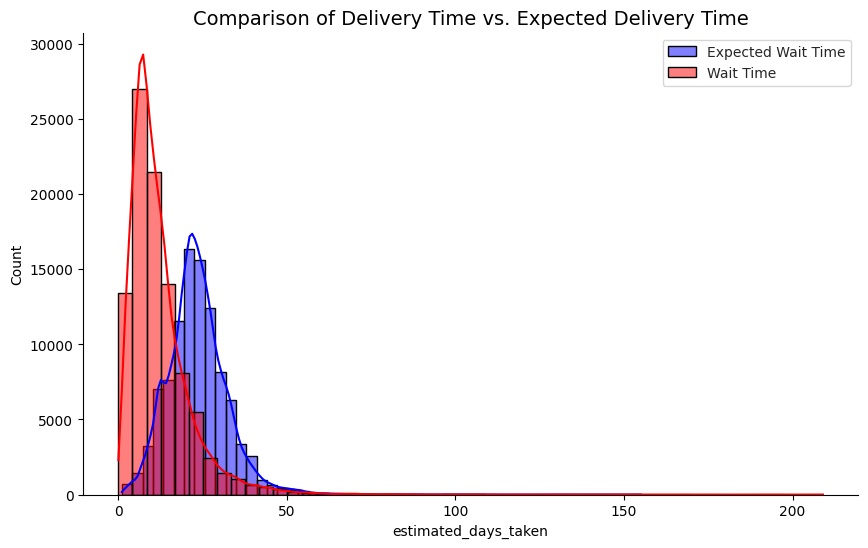

In [ ]:
#plotting a graph to compare delivery time vs expected delivery time
plt.figure(figsize=(10, 6))
sns.histplot(df_orders['estimated_days_taken'], bins=50, color='blue', kde=True, label='Expected Wait Time')
sns.histplot(df_orders['days_taken'], bins=50, color='red', kde=True, label='Wait Time')
plt.title('Comparison of Delivery Time vs. Expected Delivery Time', fontsize=14)

sns.set_style("whitegrid")
sns.despine()
plt.legend()

In [ ]:
#average days taken for delivery
days_taken_mean = df_orders['days_taken'].mean()
print('The average days taken for delivery is: ', days_taken_mean, ' days')

The average days taken for delivery is:  12.094085575687217  days


In [ ]:
#average days taken for delivery
estimated_days_taken_mean = df_orders['estimated_days_taken'].mean()
print('The estimated average days taken for delivery is: ', estimated_days_taken_mean, ' days')

The estimated average days taken for delivery is:  23.403958125923914  days


In [ ]:
#order status
order_status = pd.DataFrame(df_orders['order_status'].value_counts()).reset_index()
order_status.columns = ['status', 'count']
order_status

,status,count
0,delivered,96478
1,shipped,1107
2,canceled,625
3,unavailable,609
4,invoiced,314
5,processing,301
6,created,5
7,approved,2


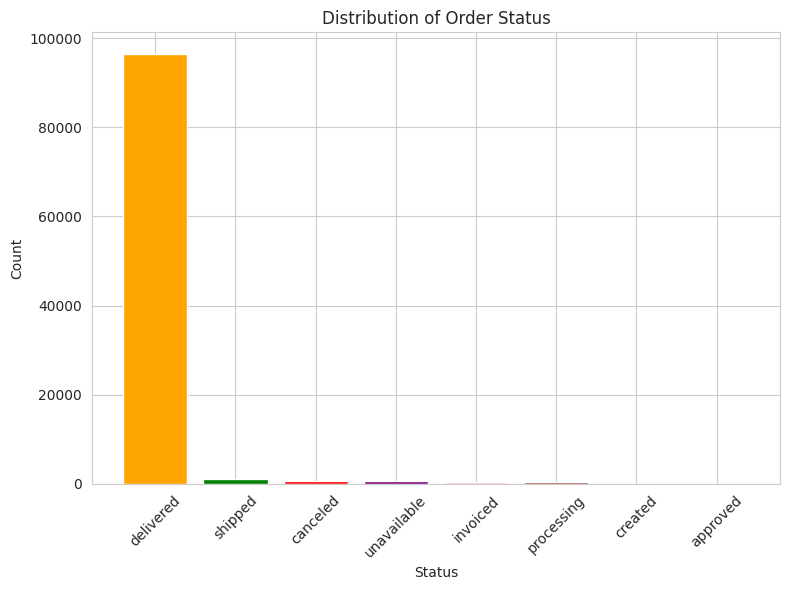

In [ ]:
#to add colours to each bar
colors = ['orange', 'green', 'red', 'purple', 'pink', 'brown', 'skyblue']

#plot graph
plt.figure(figsize=(8, 6))
plt.bar(order_status['status'], order_status['count'], color= colors)  # Provide 'status' and 'count' columns
plt.xlabel('Status')
plt.ylabel('Count')
plt.title('Distribution of Order Status')  # Add title
plt.xticks(rotation=45, ha='center')  # Rotate x-axis labels for better visibility


plt.tight_layout()

# Show plot
plt.show()

In [ ]:
# Calculate the total count of orders
total_orders = order_status['count'].sum()

# Calculate the percentage for each order status
order_status['percentage'] = (order_status['count'] / total_orders) * 100

# Print or display the result
print(order_status)

        status  count  percentage
0    delivered  96478   97.020344
1      shipped   1107    1.113223
2     canceled    625    0.628513
3  unavailable    609    0.612423
4     invoiced    314    0.315765
5   processing    301    0.302692
6      created      5    0.005028
7     approved      2    0.002011


In [ ]:
# Create a new column to store delivery status
df_orders['delivery_time'] = ''

# Update delivery status based on comparison
for index, row in df_orders.iterrows():
    if row['estimated_days_taken'] < row['days_taken']:
        df_orders.at[index, 'delivery_time'] = 'Late'
    else:
        df_orders.at[index, 'delivery_time'] = 'On Time'

df_orders



,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,time_difference,estimated_time_difference,days_taken,estimated_days_taken,delivery_time
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,8 days 10:28:40,15 days 13:03:27,8.0,15,On Time
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13,13 days 18:46:08,19 days 03:18:23,13.0,19,On Time
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04,9 days 09:27:40,26 days 15:21:11,9.0,26,On Time
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15,13 days 05:00:36,26 days 04:31:54,13.0,26,On Time
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26,2 days 20:58:23,12 days 02:41:21,2.0,12,On Time
...,...,...,...,...,...,...,...,...,...,...,...,...,...
99436,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28,8 days 05:13:56,18 days 14:05:55,8.0,18,On Time
99437,63943bddc261676b46f01ca7ac2f7bd8,1fca14ff2861355f6e5f14306ff977a7,delivered,2018-02-06 12:58:58,2018-02-06 13:10:37,2018-02-07 23:22:42,2018-02-28 17:37:56,2018-03-02,22 days 04:38:58,23 days 11:01:02,22.0,23,On Time
99438,83c1379a015df1e13d02aae0204711ab,1aa71eb042121263aafbe80c1b562c9c,delivered,2017-08-27 14:46:43,2017-08-27 15:04:16,2017-08-28 20:52:26,2017-09-21 11:24:17,2017-09-27,24 days 20:37:34,30 days 09:13:17,24.0,30,On Time
99439,11c177c8e97725db2631073c19f07b62,b331b74b18dc79bcdf6532d51e1637c1,delivered,2018-01-08 21:28:27,2018-01-08 21:36:21,2018-01-12 15:35:03,2018-01-25 23:32:54,2018-02-15,17 days 02:04:27,37 days 02:31:33,17.0,37,On Time


In [ ]:
#checking the number of late orders vs on time
df_orders['delivery_time'].value_counts()

On Time    92133
Late        7308
Name: delivery_time, dtype: int64

In [ ]:
# Calculate the counts of on time and late orders
on_time_count = df_orders['delivery_time'].value_counts()['On Time']
late_count = df_orders['delivery_time'].value_counts()['Late']

# Calculate the total number of orders
total_orders = on_time_count + late_count

# Calculate the percentage of on time and late orders
on_time_percentage = (on_time_count / total_orders) * 100
late_percentage = (late_count / total_orders) * 100

# Print the results
print("The number of orders delivered on time is:", on_time_count)
print("The number of orders delivered late is:", late_count)
print("Percentage of on time orders:", on_time_percentage)
print("Percentage of late orders:", late_percentage)

The number of orders delivered on time is: 92133
The number of orders delivered late is: 7308
Percentage of on time orders: 92.6509186351706
Percentage of late orders: 7.349081364829396


In [ ]:
all_orders_reviews_products = pd.merge(
    df_orders,
    df_order_reviews_products,
    on= 'order_id',
    how='inner'
    )

all_orders_reviews_products.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 112372 entries, 0 to 112371
Data columns (total 34 columns):
 #   Column                         Non-Null Count   Dtype          
---  ------                         --------------   -----          
 0   order_id                       112372 non-null  object         
 1   customer_id                    112372 non-null  object         
 2   order_status                   112372 non-null  object         
 3   order_purchase_timestamp       112372 non-null  datetime64[ns] 
 4   order_approved_at              112357 non-null  datetime64[ns] 
 5   order_delivered_carrier_date   111188 non-null  datetime64[ns] 
 6   order_delivered_customer_date  110012 non-null  datetime64[ns] 
 7   order_estimated_delivery_date  112372 non-null  datetime64[ns] 
 8   time_difference                110012 non-null  timedelta64[ns]
 9   estimated_time_difference      112372 non-null  timedelta64[ns]
 10  days_taken                     110012 non-null  float64 

<ipython-input-54-7c1e57d75fa3>:5: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



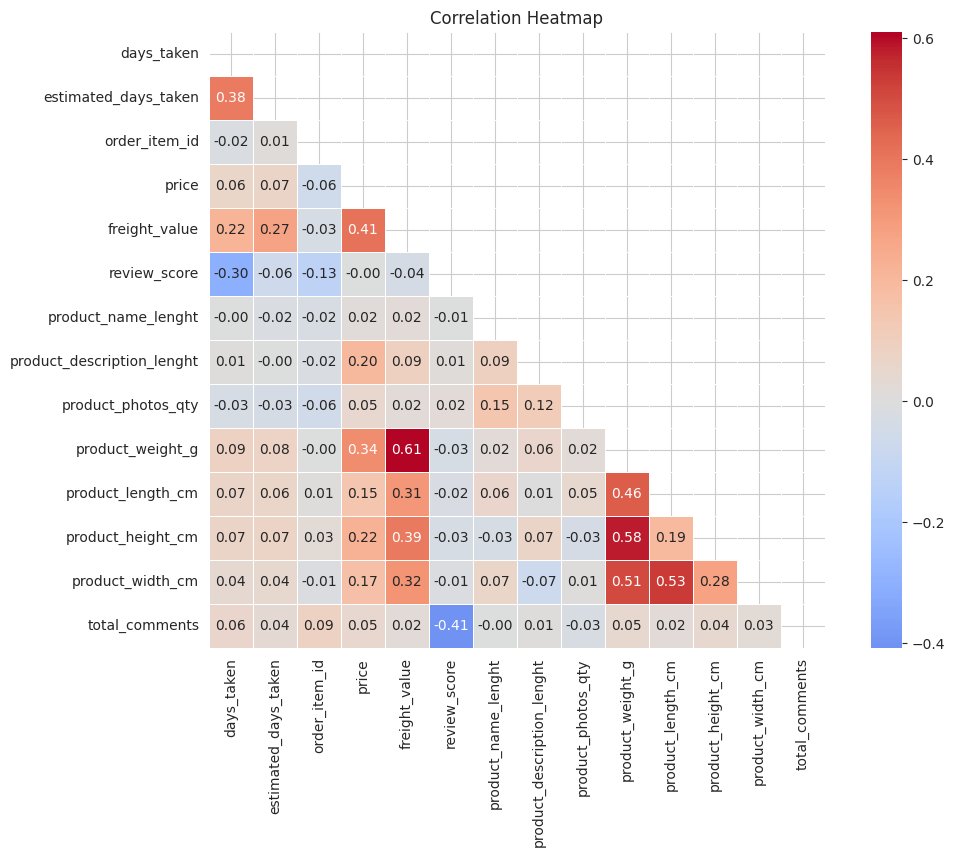

In [ ]:
# Select numerical columns for correlation calculation
numerical_columns = all_orders_reviews_products.select_dtypes(include=['float64', 'int64', 'datetime64[ns]', 'timedelta64[ns]']).columns

# Compute the correlation matrix
corr_matrix = all_orders_reviews_products[numerical_columns].corr()

# Generate a mask for the upper triangle
mask = pd.DataFrame(data=np.triu(np.ones(corr_matrix.shape, dtype=bool)), columns=corr_matrix.columns, index=corr_matrix.index)

# Set up the matplotlib figure
plt.figure(figsize=(12, 8))

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_matrix, mask=mask, cmap='coolwarm', annot=True, fmt=".2f", center=0, square=True, linewidths=.5)

# Add title
plt.title('Correlation Heatmap')

# Show plot
plt.show()

In [ ]:
#In the table above we can see that there is a strong negative correlation with the review_score and total comments and there is a strong negative correlation with the review_score and days taken to deliver the items.

In [ ]:
# Calculate the number of orders per customer
order_count_per_customer = all_orders_reviews_products.groupby('customer_id')['order_id'].nunique()

In [ ]:
# Calculate the total amount spent by each customer
all_orders_reviews_products['total_amount'] = all_orders_reviews_products['price'] + all_orders_reviews_products['freight_value']
total_spent_per_customer = pd.DataFrame(all_orders_reviews_products.groupby('customer_id')['total_amount'].sum()).reset_index()
total_spent_per_customer

,customer_id,total_amount
0,00012a2ce6f8dcda20d059ce98491703,114.74
1,000161a058600d5901f007fab4c27140,67.41
2,0001fd6190edaaf884bcaf3d49edf079,195.42
3,0002414f95344307404f0ace7a26f1d5,179.35
4,000379cdec625522490c315e70c7a9fb,107.01
...,...,...
97912,fffcb937e9dd47a13f05ecb8290f4d3e,91.91
97913,fffecc9f79fd8c764f843e9951b11341,81.36
97914,fffeda5b6d849fbd39689bb92087f431,63.13
97915,ffff42319e9b2d713724ae527742af25,214.13


In [ ]:
all_orders_reviews_products_graph = pd.merge(
    all_orders_reviews_products,
    total_spent_per_customer,
    on= 'customer_id',
    how='inner'
    )

all_orders_reviews_products.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 112372 entries, 0 to 112371
Data columns (total 35 columns):
 #   Column                         Non-Null Count   Dtype          
---  ------                         --------------   -----          
 0   order_id                       112372 non-null  object         
 1   customer_id                    112372 non-null  object         
 2   order_status                   112372 non-null  object         
 3   order_purchase_timestamp       112372 non-null  datetime64[ns] 
 4   order_approved_at              112357 non-null  datetime64[ns] 
 5   order_delivered_carrier_date   111188 non-null  datetime64[ns] 
 6   order_delivered_customer_date  110012 non-null  datetime64[ns] 
 7   order_estimated_delivery_date  112372 non-null  datetime64[ns] 
 8   time_difference                110012 non-null  timedelta64[ns]
 9   estimated_time_difference      112372 non-null  timedelta64[ns]
 10  days_taken                     110012 non-null  float64 

In [ ]:
all_orders_reviews_products['review_creation_date'] = all_orders_reviews_products['review_creation_date'].dt.date


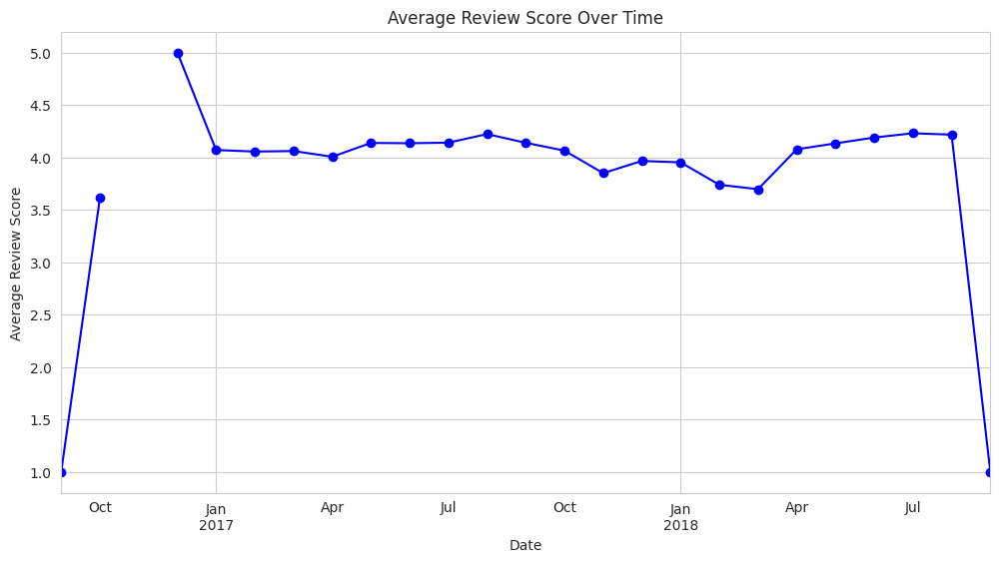

In [ ]:
# Group by month and calculate the average review score
monthly_avg_review_score = all_orders_reviews_products.resample('M', on='order_purchase_timestamp')['review_score'].mean()

# Plotting
plt.figure(figsize=(12, 6))
monthly_avg_review_score.plot(marker='o', color='b')
plt.title('Average Review Score Over Time')
plt.xlabel('Date')
plt.ylabel('Average Review Score')
plt.grid(True)
plt.show()